# Set up Environment

In [1]:
import scanpy as sc
import numpy as np
import pandas as pd
import seaborn as sns
import statsmodels
from matplotlib import pyplot as plt

In [2]:
sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_versions()
sc.settings.set_figure_params(dpi=80, facecolor='white')

scanpy==1.5.1 anndata==0.7.3 umap==0.4.4 numpy==1.19.0 scipy==1.4.1 pandas==1.0.5 scikit-learn==0.23.1 statsmodels==0.11.1 python-igraph==0.8.2 louvain==0.7.0 leidenalg==0.8.1


# Load Data

In [3]:
dataset_names =['HN289_Pri','HN290_Pri','HN295','HN296_Pri_CD8pos','HN305_1_Pri','HN307_Pri','HN309_Pri','HN310','HN314','HN316',
          'HN290_LN2','HN291_Pri','HN296_Pri_CD8neg','HN304_Pri','HN305_2_Pri','HN307_sLN','HN309_sLN','HN313','HN315']

In [4]:
data_sets = {}
for name in dataset_names:
    file_path = '/data/scRNA/'+name+'/filtered_feature_bc_matrix'
    data_sets[name] = sc.read_10x_mtx(file_path,var_names='gene_symbols',cache=True)
    data_sets[name].var_names_make_unique(join='_')

... reading from cache file cache/data-scRNA-HN289_Pri-filtered_feature_bc_matrix-matrix.h5ad
... reading from cache file cache/data-scRNA-HN290_Pri-filtered_feature_bc_matrix-matrix.h5ad
... reading from cache file cache/data-scRNA-HN295-filtered_feature_bc_matrix-matrix.h5ad
... reading from cache file cache/data-scRNA-HN296_Pri_CD8pos-filtered_feature_bc_matrix-matrix.h5ad
... reading from cache file cache/data-scRNA-HN305_1_Pri-filtered_feature_bc_matrix-matrix.h5ad
... reading from cache file cache/data-scRNA-HN307_Pri-filtered_feature_bc_matrix-matrix.h5ad
... reading from cache file cache/data-scRNA-HN309_Pri-filtered_feature_bc_matrix-matrix.h5ad
... reading from cache file cache/data-scRNA-HN310-filtered_feature_bc_matrix-matrix.h5ad
... reading from cache file cache/data-scRNA-HN314-filtered_feature_bc_matrix-matrix.h5ad
... reading from cache file cache/data-scRNA-HN316-filtered_feature_bc_matrix-matrix.h5ad
... reading from cache file cache/data-scRNA-HN290_LN2-filtered_fea

#### Check that all files are loaded, there should be 19 samples in total

In [5]:
len(data_sets)

19

#### Adding sample, group and batch labels to the data objects

In [6]:
# sample label
for name in dataset_names: 
    data_sets[name].obs['sample'] = name
    
# group label
for name in dataset_names:
    if name.find('LN')!=-1:
        data_sets[name].obs['group'] = 'Metastatic'
    else:
        data_sets[name].obs['group'] = 'Primary'  
        
# batch label
batches = {'batch1':['HN289_Pri','HN290_Pri','HN290_LN2','HN291_Pri'],
           'batch2':['HN296_Pri_CD8pos','HN305_1_Pri','HN296_Pri_CD8neg','HN304_Pri','HN305_2_Pri'],
           'batch3':['HN295','HN307_Pri','HN309_Pri','HN310','HN314','HN316','HN307_sLN','HN309_sLN','HN313','HN315']}
for batch in batches:
    for name in batches[batch]:
        data_sets[name].obs['bat'] = batch

#### Merging all datasets

In [7]:
combined = data_sets['HN289_Pri'].concatenate(data_sets[name] for name in data_sets if name!='HN289_Pri')

In [8]:
combined

AnnData object with n_obs × n_vars = 106238 × 33538
    obs: 'sample', 'group', 'bat', 'batch'
    var: 'gene_ids', 'feature_types'

# QC Metrics

In [9]:
sc.pp.calculate_qc_metrics(combined, inplace=True)

In [10]:
# Check the computed metric names
# log1p: log(X+1) transform
combined

AnnData object with n_obs × n_vars = 106238 × 33538
    obs: 'sample', 'group', 'bat', 'batch', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes'
    var: 'gene_ids', 'feature_types', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'

#### Next compute metrics for mitochondrial genes and ribosomal genes

In [11]:
# Mitochondrial genes
mito_genes = combined.var_names.str.startswith('MT-')
# for each cell compute fraction of counts in mito genes vs. all genes
# the `.A1` is only necessary as X is sparse (to transform to a dense array after summing)
combined.obs['percent_mito'] = np.sum(combined[:, mito_genes].X, axis=1).A1 / np.sum(combined.X, axis=1).A1
# add the total counts per cell as observations-annotation to adata
combined.obs['n_counts'] = combined.X.sum(axis=1).A1

# Ribosomal genes
ribo_genes = combined.var_names.str.startswith(("RPS","RPL"))
combined.obs['percent_ribo'] = np.sum(combined[:, ribo_genes].X, axis=1).A1 / np.sum(combined.X, axis=1).A1

#### Look at the number of mitochondrial genes and ribosomal genes detected

In [12]:
print("The total number of detected mitochondrial genes in all samples: {}".format(sum(mito_genes)))
print("The total number of detected ribosomal genes in all samples: {}".format(sum(ribo_genes)))

The total number of detected mitochondrial genes in all samples: 13
The total number of detected ribosomal genes in all samples: 104


# QC Filtering

## Primary Filtering for all samples
#### Here we first filter out the cells that have fewer than 200 detected genes (dead, broken cells) and genes that are detected in fewer than 3 cells (genes with no statistical significance)

In [13]:
print("In the primary filtering step: ")
sc.pp.filter_cells(combined, min_genes=200)
sc.pp.filter_genes(combined, min_cells=3)

In the primary filtering step: 
filtered out 26922 cells that have less than 200 genes expressed
filtered out 7870 genes that are detected in less than 3 cells


In [14]:
kept_cell = {} # kept_cell holds all the cells and genes that are not filtered

#### We then filter sample by sample since the number of cells vary significantly across samples. The overall idea is:

#### (1) Look at the original distributions, and determine the filter thresholds 

#### (2) Usually, filter below the double bellies of the violin plot, if the lower belly is somewhat much smaller than the top belly, whatever lies below probably are dead cells, broken cells) at the bottome and needles on top (probably multiplets)

#### (3) Filter according to the threshold and plot again to see if the violin plots have a "good" violin shape

#### Here are the involved variables and meanings
#### n_counts: total number of reads per cell
#### n_genes_by_counts: the number mapped genes 
#### percent_mito: percent of mitochondrial reads in total number of reads
#### percent_ribo: percent of ribosomal reads in total number of reads

In [15]:
# Since we have debugged the code and know that everything works fine, we now supress all kinds of unwanted messages generated
# and only keep the printed or necessary results. This is for the purpose of better readability of the .pdf report generated.

import warnings
warnings.simplefilter('ignore')

import logging, sys
logging.disable(sys.maxsize)

## Cell-filtering for HN289_Pri

Pre-filter violin plots


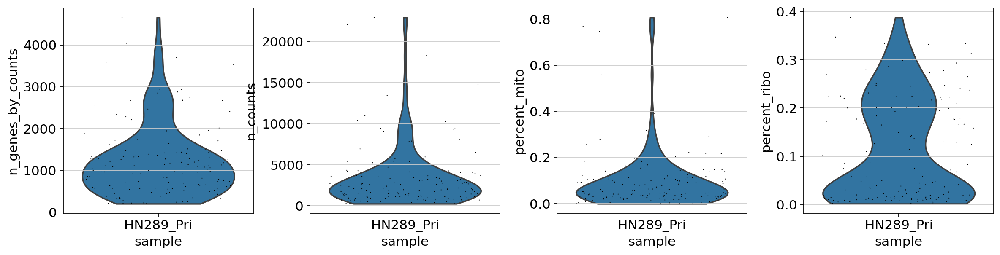

Post-filter violin plots


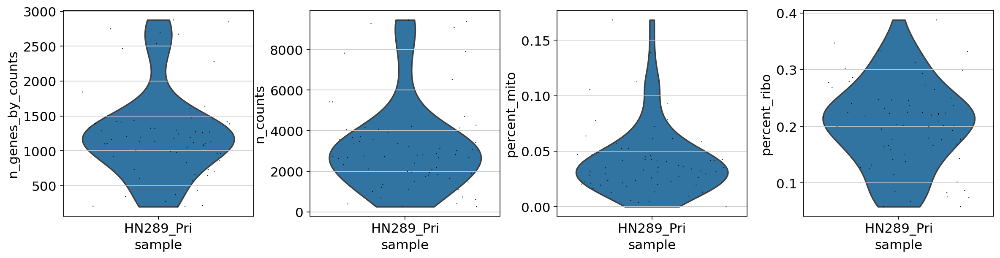

Filtered out 74 cells, number left in HN289_Pri is 68


In [16]:
HN289_Pri = combined[combined.obs['sample']=='HN289_Pri'];

print("Pre-filter violin plots");
sc.pl.violin(HN289_Pri, ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample');

# filter for HN289_Pri
kept_cell['HN289_Pri'] = (combined.obs['n_counts'] < 10000) & (combined.obs['sample'] == 'HN289_Pri') & (combined.obs['percent_mito'] < 0.4) & (combined.obs['percent_ribo'] > 0.05);
number_filtered = str(len(combined[combined.obs['sample']=='HN289_Pri'].obs['total_counts'])-sum(kept_cell['HN289_Pri']));

print("Post-filter violin plots");
sc.pl.violin(combined[kept_cell['HN289_Pri'],:], ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample');

print("Filtered out {} cells, number left in HN289_Pri is {}".format(number_filtered,str(sum(kept_cell['HN289_Pri']))));

## Cell-filtering for HN290_Pri

Look at the original distributions

Pre-filter violin plots


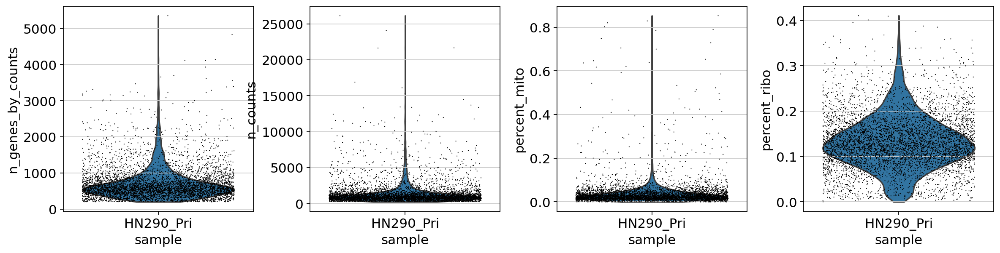

Post-filter violin plots


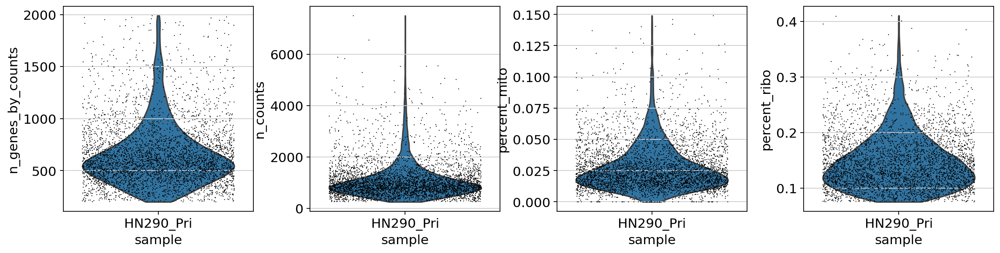

Filtered out 902 cells, number left in HN290_Pri is 4328


In [17]:
HN290_Pri = combined[combined.obs['sample']=='HN290_Pri']

print("Pre-filter violin plots")
sc.pl.violin(HN290_Pri, ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample');

# filter for HN290_Pri
kept_cell['HN290_Pri'] = (combined.obs['n_genes_by_counts'] < 2000) & (combined.obs['sample'] == 'HN290_Pri') & (combined.obs['percent_mito'] < 0.15) & (combined.obs['percent_ribo'] > 0.075)
number_filtered = str(len(combined[combined.obs['sample']=='HN290_Pri'].obs['total_counts'])-sum(kept_cell['HN290_Pri']))

print("Post-filter violin plots")
sc.pl.violin(combined[kept_cell['HN290_Pri'],:], ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample');

print("Filtered out {} cells, number left in HN290_Pri is {}".format(number_filtered,str(sum(kept_cell['HN290_Pri']))))

## Cell-filtering for HN290_LN2

Pre-filter violin plots


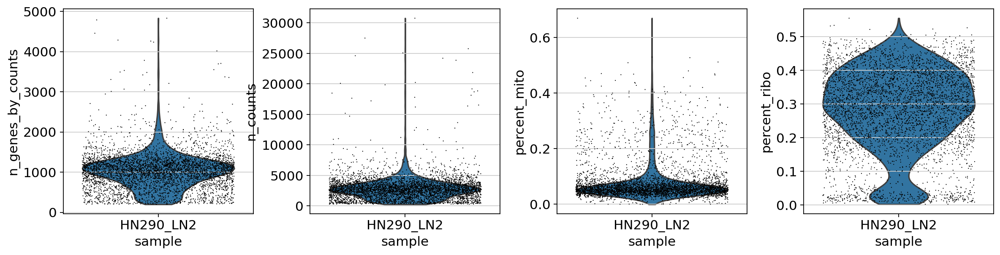

Post-filter violin plots


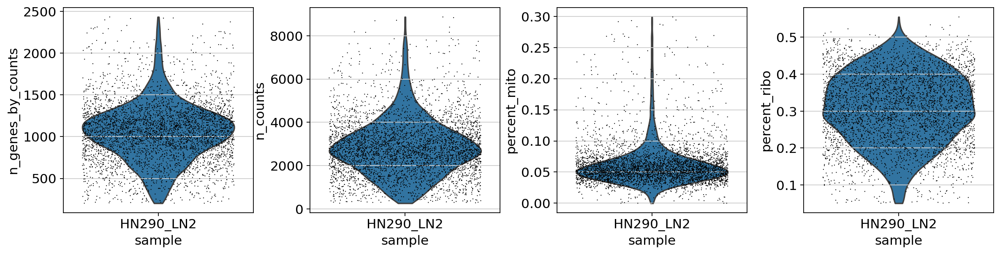

Filtered out 418 cells, number left in HN290_LN2 is 4114


In [18]:
HN290_LN2 = combined[combined.obs['sample']=='HN290_LN2']

print("Pre-filter violin plots")
sc.pl.violin(HN290_LN2, ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample');

# filter for HN290_LN2
kept_cell['HN290_LN2'] = (combined.obs['n_genes_by_counts'] < 2500) & (combined.obs['sample'] == 'HN290_LN2') & (combined.obs['n_counts'] <9000) & (combined.obs['percent_mito'] < 0.3) & (combined.obs['percent_ribo'] > 0.05)
number_filtered = str(len(combined[combined.obs['sample']=='HN290_LN2'].obs['total_counts'])-sum(kept_cell['HN290_LN2']))

print("Post-filter violin plots")
sc.pl.violin(combined[kept_cell['HN290_LN2'],:], ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample');

print("Filtered out {} cells, number left in HN290_LN2 is {}".format(number_filtered,str(sum(kept_cell['HN290_LN2']))))

## Cell-filtering for HN291_Pri

Pre-filter violin plots


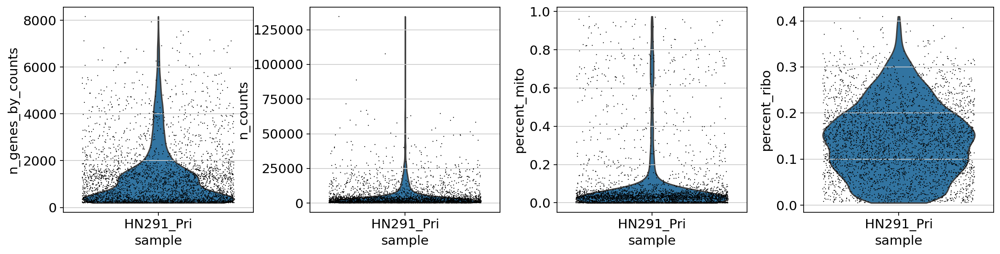

Post-filter violin plots


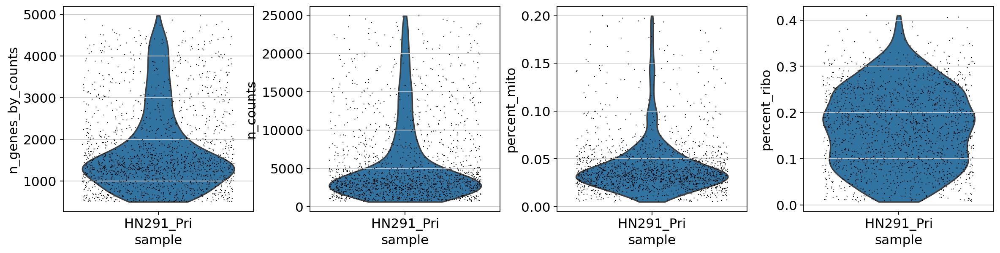

Filtered out 1916 cells, number left in HN291_Pri is 1710


In [19]:
HN291_Pri = combined[combined.obs['sample']=='HN291_Pri']

print("Pre-filter violin plots")
sc.pl.violin(HN291_Pri, ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample');

# filter for HN291_Pri
kept_cell['HN291_Pri'] = (combined.obs['n_genes_by_counts'] < 5000) &(combined.obs['n_genes_by_counts'] > 500) &(combined.obs['percent_mito'] > 0.005)& (combined.obs['sample'] == 'HN291_Pri') & (combined.obs['n_counts'] <25000) & (combined.obs['percent_mito'] < 0.20) & (combined.obs['percent_ribo']>0.)
number_filtered = str(len(combined[combined.obs['sample']=='HN291_Pri'].obs['total_counts'])-sum(kept_cell['HN291_Pri']))

print("Post-filter violin plots")
sc.pl.violin(combined[kept_cell['HN291_Pri'],:], ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample');

print("Filtered out {} cells, number left in HN291_Pri is {}".format(number_filtered,str(sum(kept_cell['HN291_Pri']))))

## Cell-filtering for HN295

Pre-filter violin plots


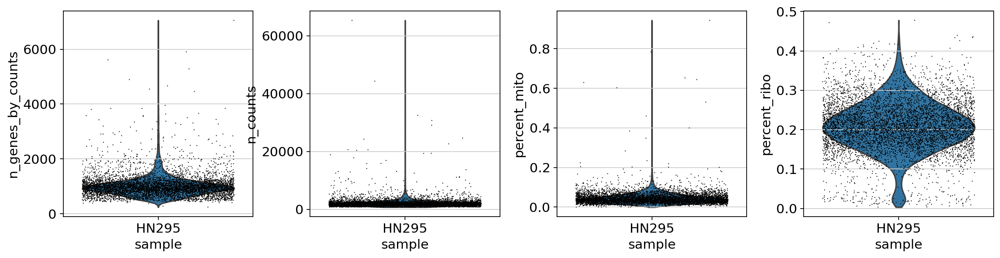

Post-filter violin plots


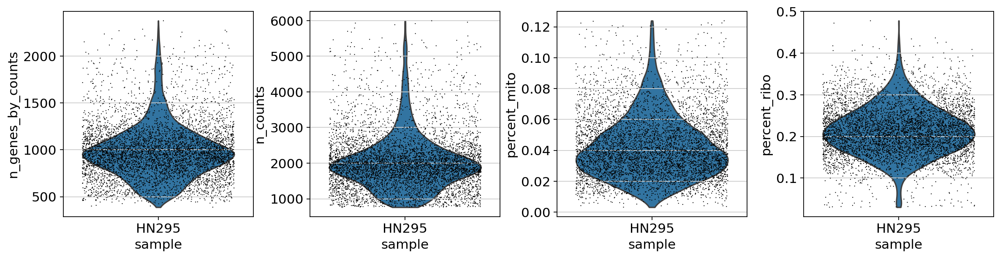

Filtered out 233 cells, number left in HN295 is 5744


In [20]:
HN295 = combined[combined.obs['sample']=='HN295']

print("Pre-filter violin plots")
sc.pl.violin(HN295, ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample');

# filter for HN295
kept_cell['HN295'] = (combined.obs['n_genes_by_counts'] <2500) &(combined.obs['percent_mito'] > 0.002)& (combined.obs['sample'] == 'HN295') & (combined.obs['n_counts'] <6000) & (combined.obs['percent_mito'] < 0.125)& (combined.obs['percent_ribo'] > 0.03)
number_filtered = str(len(combined[combined.obs['sample']=='HN295'].obs['total_counts'])-sum(kept_cell['HN295']))

print("Post-filter violin plots")
sc.pl.violin(combined[kept_cell['HN295'],:], ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample');

print("Filtered out {} cells, number left in HN295 is {}".format(number_filtered,str(sum(kept_cell['HN295']))))

## Cell-filtering for HN296_Pri_CD8pos

Pre-filter violin plots


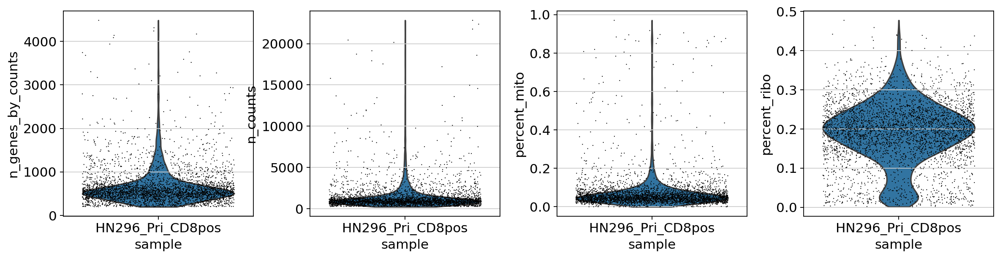

Post-filter violin plots


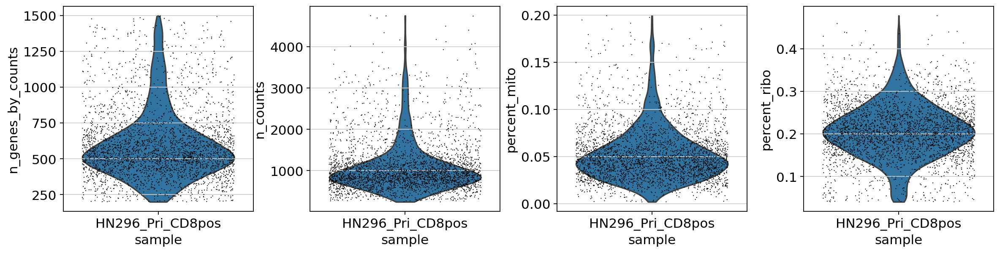

Filtered out 476 cells, number left in HN296_Pri_CD8pos is 3214


In [21]:
HN296_Pri_CD8pos = combined[combined.obs['sample']=='HN296_Pri_CD8pos']

print("Pre-filter violin plots")
sc.pl.violin(HN296_Pri_CD8pos, ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample');

# filter for HN296_Pri_CD8pos
kept_cell['HN296_Pri_CD8pos'] = (combined.obs['n_genes_by_counts'] <1500) &(combined.obs['percent_mito'] > 0.002)& (combined.obs['sample'] == 'HN296_Pri_CD8pos') & (combined.obs['n_counts'] <5000) & (combined.obs['percent_mito'] < 0.20)& (combined.obs['percent_ribo'] > 0.04)
number_filtered = str(len(combined[combined.obs['sample']=='HN296_Pri_CD8pos'].obs['total_counts'])-sum(kept_cell['HN296_Pri_CD8pos']))

print("Post-filter violin plots")
sc.pl.violin(combined[kept_cell['HN296_Pri_CD8pos'],:], ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample');

print("Filtered out {} cells, number left in HN296_Pri_CD8pos is {}".format(number_filtered,str(sum(kept_cell['HN296_Pri_CD8pos']))))

## Cell-filtering for HN296_Pri_CD8neg

Pre-filter violin plots


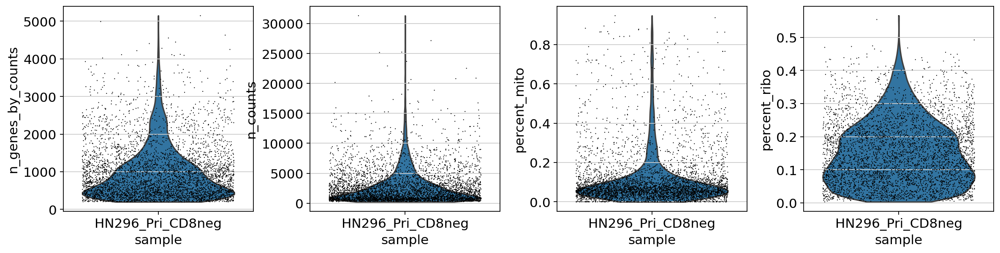

Post-filter violin plots


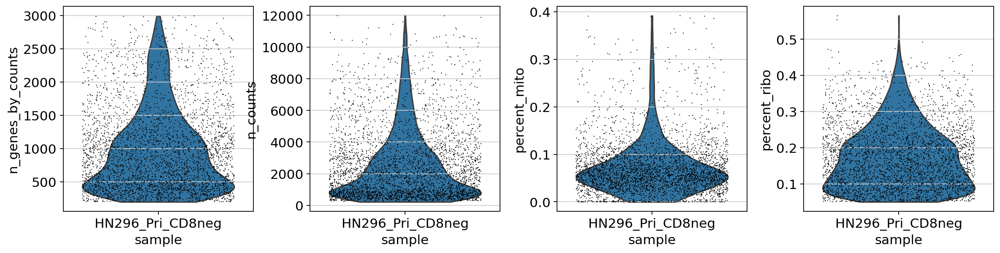

Filtered out 881 cells, number left in HN296_Pri_CD8neg is 3625


In [22]:
HN296_Pri_CD8neg = combined[combined.obs['sample']=='HN296_Pri_CD8neg']

print("Pre-filter violin plots")
sc.pl.violin(HN296_Pri_CD8neg, ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample');

# filter for HN296_Pri_CD8neg
kept_cell['HN296_Pri_CD8neg'] = (combined.obs['n_genes_by_counts'] <3000) & (combined.obs['sample'] == 'HN296_Pri_CD8neg') & (combined.obs['n_counts'] <12000) & (combined.obs['percent_mito'] < 0.4) & (combined.obs['percent_ribo']>0.05)
number_filtered = str(len(combined[combined.obs['sample']=='HN296_Pri_CD8neg'].obs['total_counts'])-sum(kept_cell['HN296_Pri_CD8neg']))

print("Post-filter violin plots")
sc.pl.violin(combined[kept_cell['HN296_Pri_CD8neg'],:], ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample');

print("Filtered out {} cells, number left in HN296_Pri_CD8neg is {}".format(number_filtered,str(sum(kept_cell['HN296_Pri_CD8neg']))))

## Cell-filtering for HN304_Pri

Pre-filter violin plots


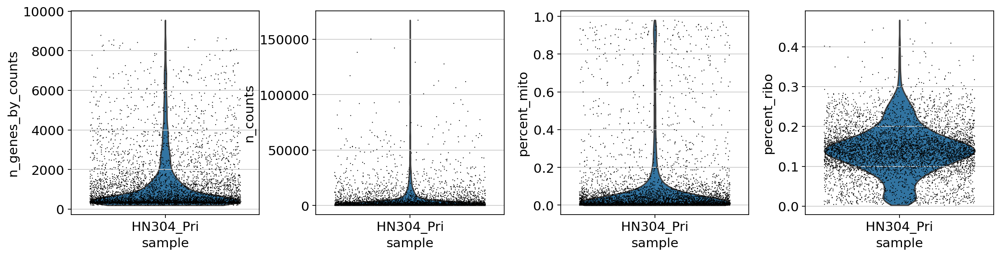

Post-filter violin plots


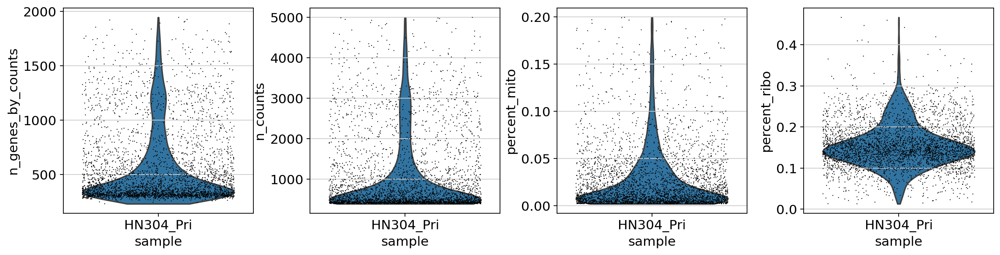

Filtered out 2289 cells, number left in HN304_Pri is 3531


In [23]:
HN304_Pri = combined[combined.obs['sample']=='HN304_Pri']

print("Pre-filter violin plots")
sc.pl.violin(HN304_Pri, ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample');

# filter for HN304_Pri
kept_cell['HN304_Pri'] = (combined.obs['n_genes_by_counts'] <2000) &(combined.obs['percent_mito'] > 0.002)& (combined.obs['sample'] == 'HN304_Pri') & (combined.obs['n_counts'] <5000) & (combined.obs['percent_mito'] < 0.20)
number_filtered = str(len(combined[combined.obs['sample']=='HN304_Pri'].obs['total_counts'])-sum(kept_cell['HN304_Pri']))

print("Post-filter violin plots")
sc.pl.violin(combined[kept_cell['HN304_Pri'],:], ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample');

print("Filtered out {} cells, number left in HN304_Pri is {}".format(number_filtered,str(sum(kept_cell['HN304_Pri']))))

## Cell-filtering for HN305_1_Pri

Pre-filter violin plots


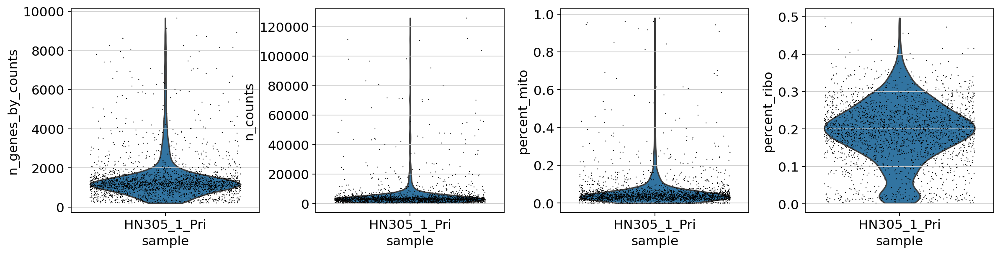

Post-filter violin plots


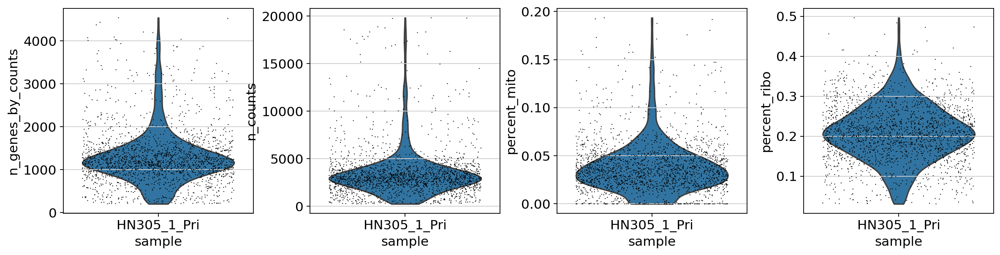

Filtered out 258 cells, number left in HN305_1_Pri is 2011


In [24]:
HN305_1_Pri = combined[combined.obs['sample']=='HN305_1_Pri']

print("Pre-filter violin plots")
sc.pl.violin(HN305_1_Pri, ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample');

# filter for HN305_1_Pri
kept_cell['HN305_1_Pri'] = (combined.obs['n_genes_by_counts'] <6000) & (combined.obs['sample'] == 'HN305_1_Pri') & (combined.obs['n_counts'] <20000) & (combined.obs['percent_mito'] < 0.20)& (combined.obs['percent_ribo'] > 0.03)
number_filtered = str(len(combined[combined.obs['sample']=='HN305_1_Pri'].obs['total_counts'])-sum(kept_cell['HN305_1_Pri']))

print("Post-filter violin plots")
sc.pl.violin(combined[kept_cell['HN305_1_Pri'],:], ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample');

print("Filtered out {} cells, number left in HN305_1_Pri is {}".format(number_filtered,str(sum(kept_cell['HN305_1_Pri']))))

## Cell-filtering for HN305_2_Pri

Pre-filter violin plots


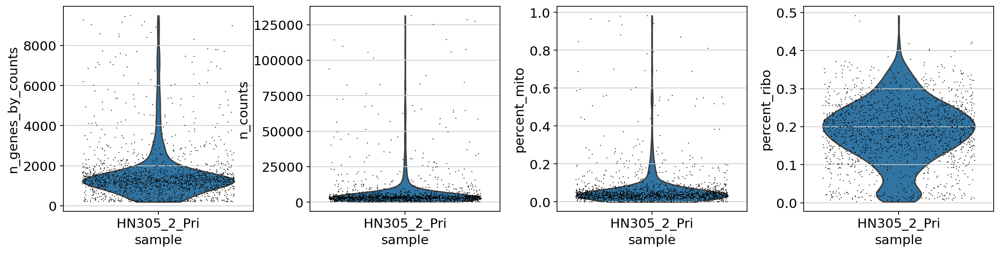

Post-filter violin plots


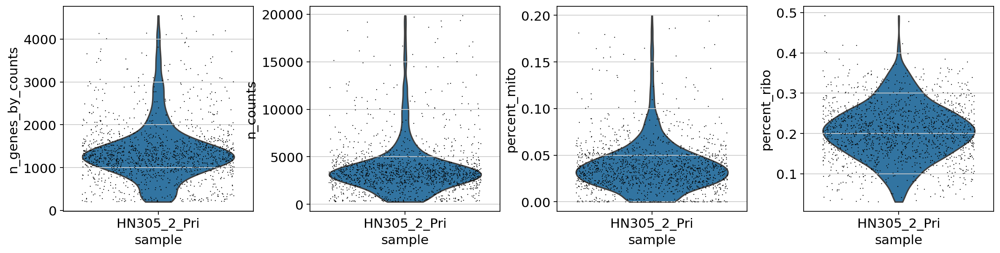

Filtered out 239 cells, number left in HN305_2_Pri is 1471


In [25]:
HN305_2_Pri = combined[combined.obs['sample']=='HN305_2_Pri']

print("Pre-filter violin plots")
sc.pl.violin(HN305_2_Pri, ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample');

# filter for HN305_2_Pri
kept_cell['HN305_2_Pri'] = (combined.obs['n_genes_by_counts'] <6000) & (combined.obs['sample'] == 'HN305_2_Pri') & (combined.obs['n_counts'] <20000) & (combined.obs['percent_mito'] < 0.20)& (combined.obs['percent_ribo'] > 0.03)
number_filtered = str(len(combined[combined.obs['sample']=='HN305_2_Pri'].obs['total_counts'])-sum(kept_cell['HN305_2_Pri']))

print("Post-filter violin plots")
sc.pl.violin(combined[kept_cell['HN305_2_Pri'],:], ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample');

print("Filtered out {} cells, number left in HN305_2_Pri is {}".format(number_filtered,str(sum(kept_cell['HN305_2_Pri']))))

## Cell-filtering for HN307_Pri

Pre-filter violin plots


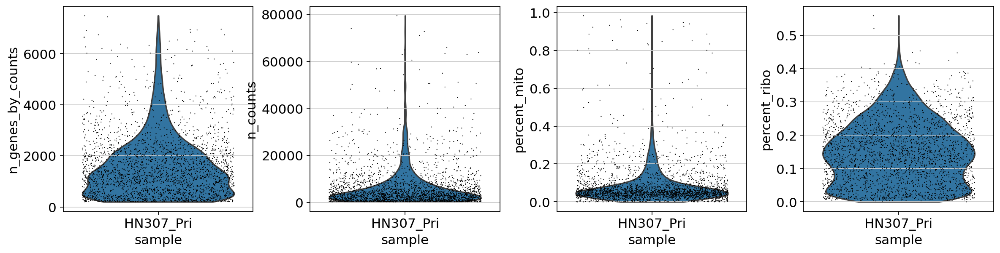

Post-filter violin plots


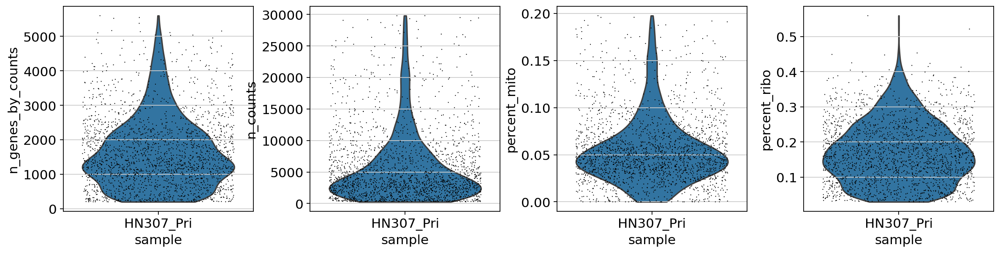

Filtered out 457 cells, number left in HN307_Pri is 2072


In [26]:
HN307_Pri = combined[combined.obs['sample']=='HN307_Pri']

print("Pre-filter violin plots")
sc.pl.violin(HN307_Pri, ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample');

# filter for HN307_Pri
kept_cell['HN307_Pri'] = (combined.obs['n_genes_by_counts'] <6000) & (combined.obs['sample'] == 'HN307_Pri') & (combined.obs['n_counts'] <30000) & (combined.obs['percent_mito'] < 0.2)& (combined.obs['percent_ribo'] > 0.03)
number_filtered = str(len(combined[combined.obs['sample']=='HN307_Pri'].obs['total_counts'])-sum(kept_cell['HN307_Pri']))

print("Post-filter violin plots")
sc.pl.violin(combined[kept_cell['HN307_Pri'],:], ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample');

print("Filtered out {} cells, number left in HN307_Pri is {}".format(number_filtered,str(sum(kept_cell['HN307_Pri']))))

## Cell-filtering for HN307_sLN

Pre-filter violin plots


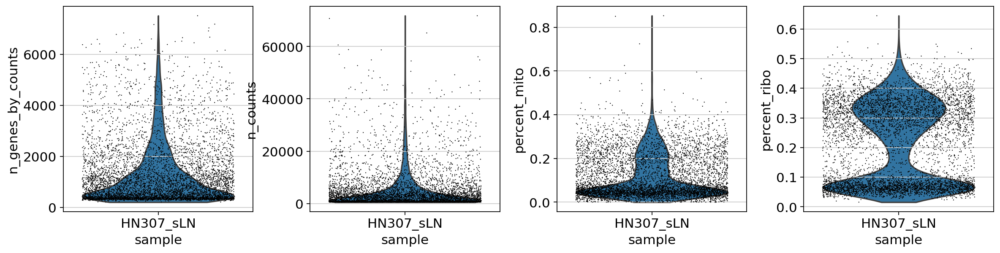

Post-filter violin plots


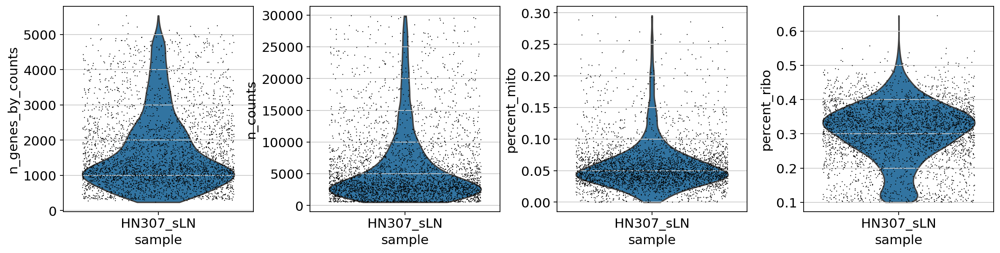

Filtered out 2390 cells, number left in HN307_sLN is 3598


In [27]:
HN307_sLN = combined[combined.obs['sample']=='HN307_sLN']

print("Pre-filter violin plots")
sc.pl.violin(HN307_sLN, ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample');

# filter for HN307_sLN
kept_cell['HN307_sLN'] = (combined.obs['n_genes_by_counts'] <6000) & (combined.obs['sample'] == 'HN307_sLN') & (combined.obs['n_counts'] <30000) & (combined.obs['percent_mito'] < 0.3) & (combined.obs['percent_ribo']>0.1)
number_filtered = str(len(combined[combined.obs['sample']=='HN307_sLN'].obs['total_counts'])-sum(kept_cell['HN307_sLN']))

print("Post-filter violin plots")
sc.pl.violin(combined[kept_cell['HN307_sLN'],:], ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample');

print("Filtered out {} cells, number left in HN307_sLN is {}".format(number_filtered,str(sum(kept_cell['HN307_sLN']))))

## Cell-filtering for HN309_Pri

Pre-filter violin plots


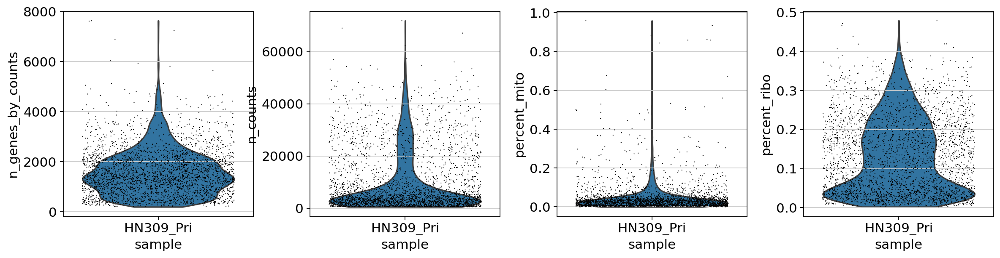

Post-filter violin plots


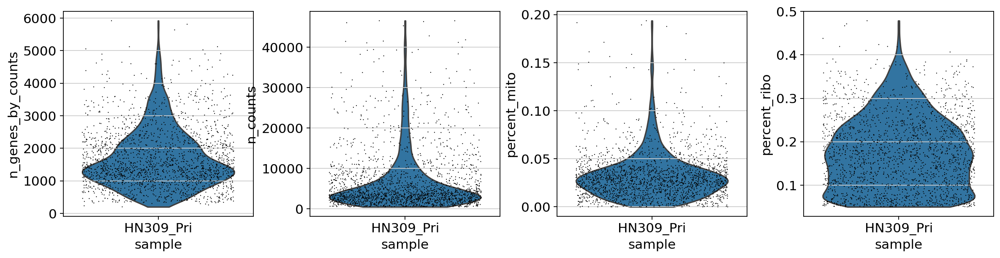

Filtered out 886 cells, number left in HN309_Pri is 2000


In [28]:
HN309_Pri = combined[combined.obs['sample']=='HN309_Pri']

print("Pre-filter violin plots")
sc.pl.violin(HN309_Pri, ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample');

# filter for HN309_Pri
kept_cell['HN309_Pri'] = (combined.obs['n_genes_by_counts'] <6000) & (combined.obs['sample'] == 'HN309_Pri') & (combined.obs['n_counts'] <50000) & (combined.obs['percent_mito'] < 0.2) & (combined.obs['percent_ribo']>0.05)
number_filtered = str(len(combined[combined.obs['sample']=='HN309_Pri'].obs['total_counts'])-sum(kept_cell['HN309_Pri']))

print("Post-filter violin plots")
sc.pl.violin(combined[kept_cell['HN309_Pri'],:], ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample');

print("Filtered out {} cells, number left in HN309_Pri is {}".format(number_filtered,str(sum(kept_cell['HN309_Pri']))))

## Cell-filtering for HN309_sLN

Pre-filter violin plots


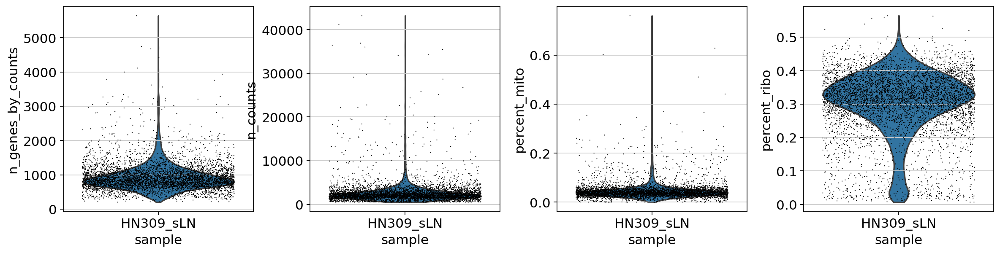

Post-filter violin plots


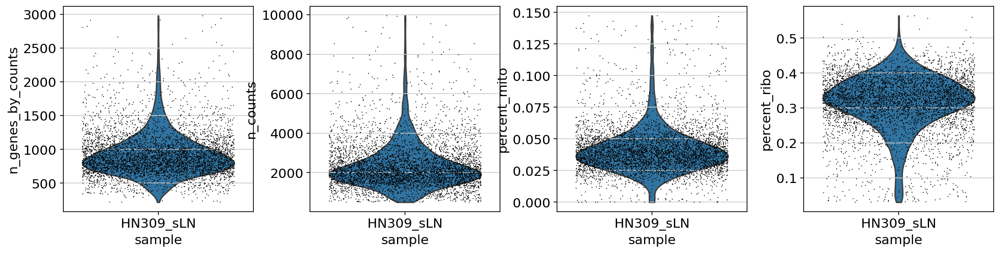

Filtered out 264 cells, number left in HN309_sLN is 4899


In [29]:
HN309_sLN = combined[combined.obs['sample']=='HN309_sLN']

print("Pre-filter violin plots")
sc.pl.violin(HN309_sLN, ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample');

# filter for HN309_sLN
kept_cell['HN309_sLN'] = (combined.obs['n_genes_by_counts'] <3000) & (combined.obs['sample'] == 'HN309_sLN') & (combined.obs['n_counts'] <10000) & (combined.obs['percent_mito'] < 0.15)& (combined.obs['percent_ribo'] > 0.03)
number_filtered = str(len(combined[combined.obs['sample']=='HN309_sLN'].obs['total_counts'])-sum(kept_cell['HN309_sLN']))

print("Post-filter violin plots")
sc.pl.violin(combined[kept_cell['HN309_sLN'],:], ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample');

print("Filtered out {} cells, number left in HN309_sLN is {}".format(number_filtered,str(sum(kept_cell['HN309_sLN']))))

## Cell-filtering for HN310

Pre-filter violin plots


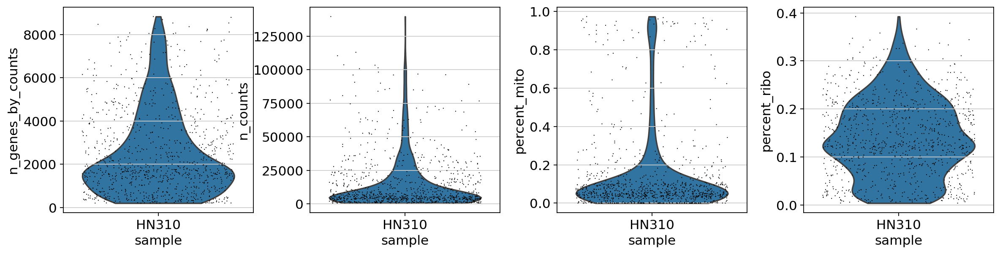

Post-filter violin plots


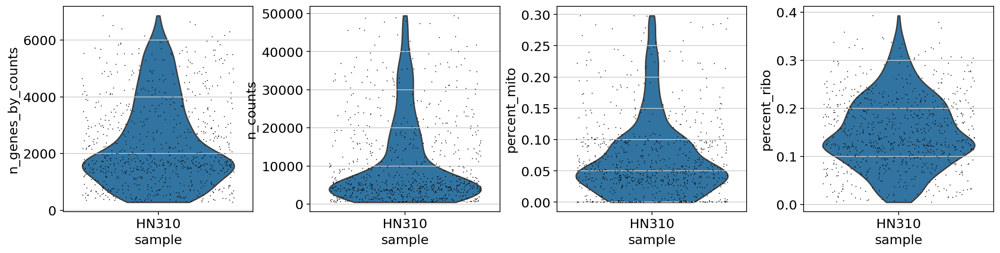

Filtered out 174 cells, number left in HN310 is 802


In [30]:
HN310 = combined[combined.obs['sample']=='HN310']

print("Pre-filter violin plots")
sc.pl.violin(HN310, ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample');

# filter for HN310
kept_cell['HN310'] = (combined.obs['n_genes_by_counts'] <10000) & (combined.obs['sample'] == 'HN310') & (combined.obs['n_counts'] <50000)& (combined.obs['percent_mito']<0.3) 
number_filtered = str(len(combined[combined.obs['sample']=='HN310'].obs['total_counts'])-sum(kept_cell['HN310']))

print("Post-filter violin plots")
sc.pl.violin(combined[kept_cell['HN310'],:], ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample');

print("Filtered out {} cells, number left in HN310 is {}".format(number_filtered,str(sum(kept_cell['HN310']))))

## Cell-filtering for HN313

Pre-filter violin plots


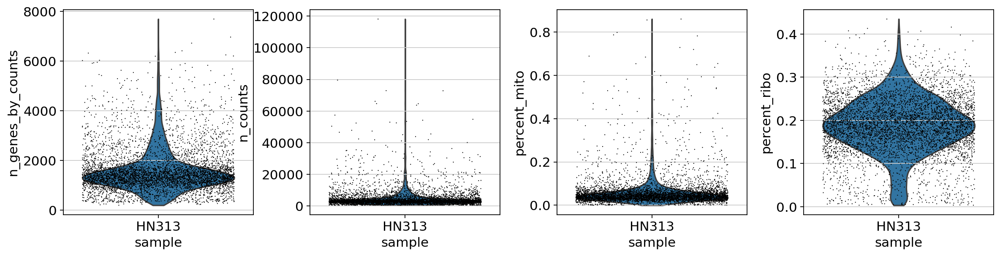

Post-filter violin plots


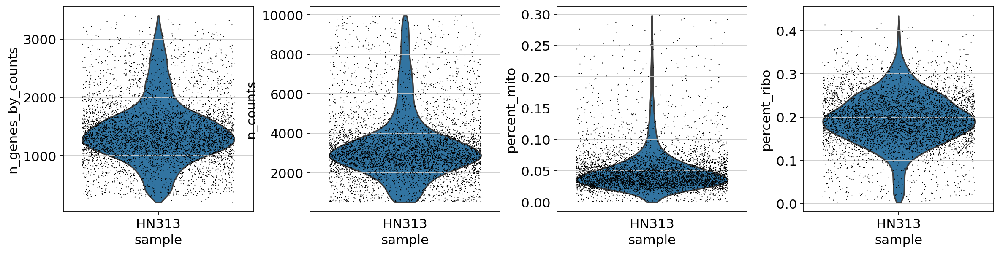

Filtered out 485 cells, number left in HN313 is 4953


In [31]:
HN313 = combined[combined.obs['sample']=='HN313']

print("Pre-filter violin plots")
sc.pl.violin(HN313, ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample');

# filter for HN313
kept_cell['HN313'] = (combined.obs['n_genes_by_counts'] <8000) & (combined.obs['sample'] == 'HN313') & (combined.obs['n_counts'] <10000) & (combined.obs['percent_mito']<0.3) 
number_filtered = str(len(combined[combined.obs['sample']=='HN313'].obs['total_counts'])-sum(kept_cell['HN313']))

print("Post-filter violin plots")
sc.pl.violin(combined[kept_cell['HN313'],:], ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample');

print("Filtered out {} cells, number left in HN313 is {}".format(number_filtered,str(sum(kept_cell['HN313']))))

## Cell-filtering for HN314

Pre-filter violin plots


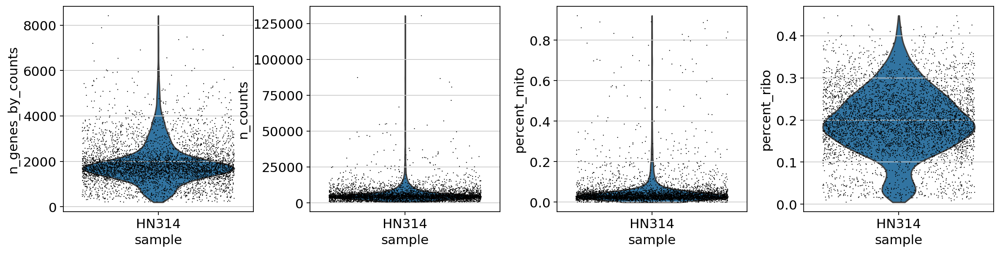

Post-filter violin plots


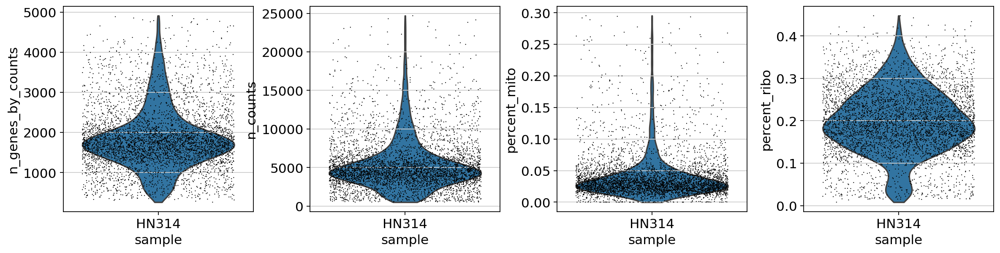

Filtered out 166 cells, number left in HN314 is 4655


In [32]:
HN314 = combined[combined.obs['sample']=='HN314']

print("Pre-filter violin plots")
sc.pl.violin(HN314, ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample');

# filter for HN314
kept_cell['HN314'] = (combined.obs['n_genes_by_counts'] <5000) & (combined.obs['sample'] == 'HN314') & (combined.obs['n_counts'] <25000) & (combined.obs['percent_mito']<0.3) 
number_filtered = str(len(combined[combined.obs['sample']=='HN314'].obs['total_counts'])-sum(kept_cell['HN314']))

print("Post-filter violin plots")
sc.pl.violin(combined[kept_cell['HN314'],:], ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample');

print("Filtered out {} cells, number left in HN314 is {}".format(number_filtered,str(sum(kept_cell['HN314']))))

## Cell-filtering for HN315

Pre-filter violin plots


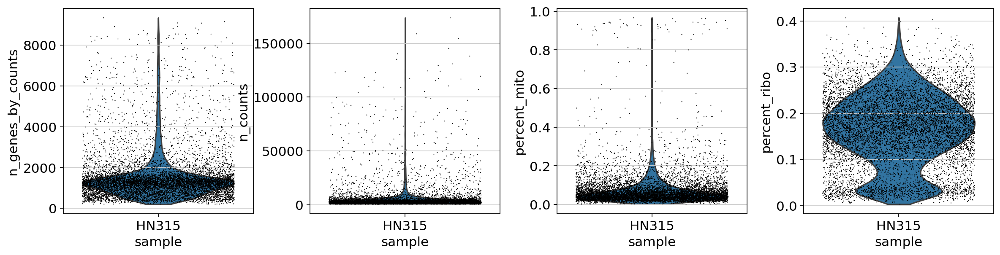

Post-filter violin plots


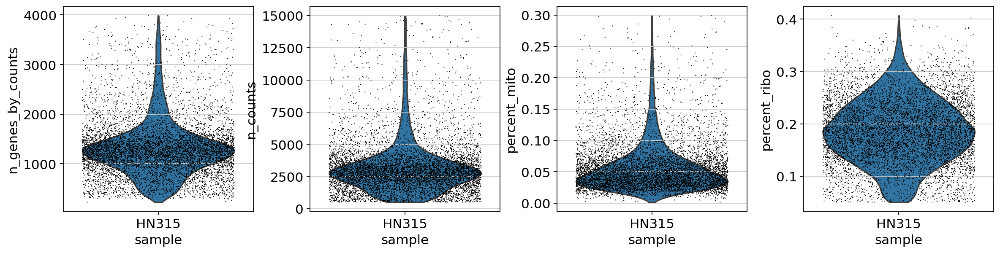

Filtered out 1545 cells, number left in HN315 is 7087


In [33]:
HN315 = combined[combined.obs['sample']=='HN315']

print("Pre-filter violin plots")
sc.pl.violin(HN315, ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample');

# filter for HN315
kept_cell['HN315'] = (combined.obs['n_genes_by_counts'] <4000) & (combined.obs['sample'] == 'HN315') & (combined.obs['n_counts'] <15000) & (combined.obs['percent_mito']<0.3) & (combined.obs['percent_ribo']>0.05)
number_filtered = str(len(combined[combined.obs['sample']=='HN315'].obs['total_counts'])-sum(kept_cell['HN315']))

print("Post-filter violin plots")

sc.pl.violin(combined[kept_cell['HN315'],:], ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample');
print("Filtered out {} cells, number left in HN315 is {}".format(number_filtered,str(sum(kept_cell['HN315']))))

## Cell-filtering for HN316

Pre-filter violin plots


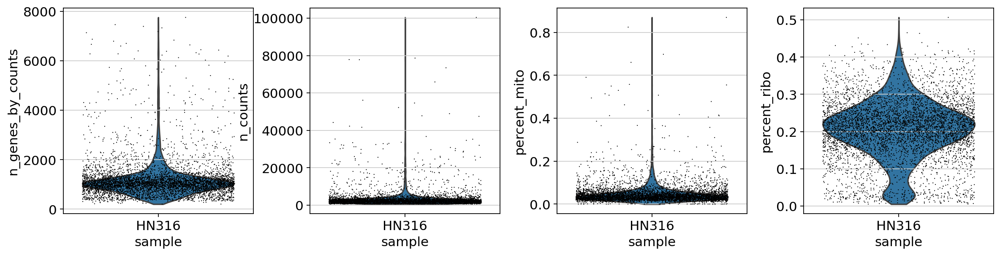

Post-filter violin plots


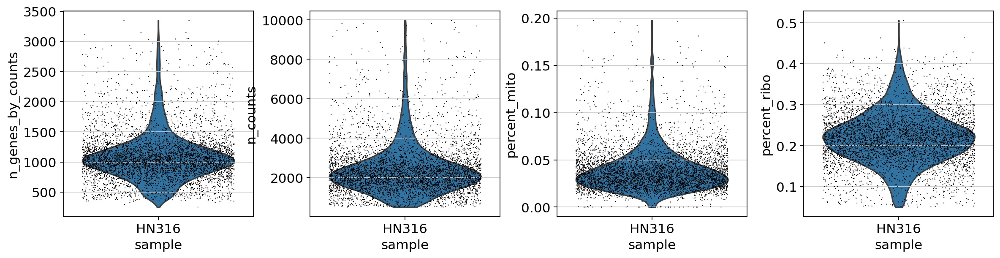

Filtered out 516 cells, number left in HN316 is 4865


In [34]:
HN316 = combined[combined.obs['sample']=='HN316']

print("Pre-filter violin plots")
sc.pl.violin(HN316, ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample');

# filter for HN316
kept_cell['HN316'] = (combined.obs['n_genes_by_counts'] <4000) & (combined.obs['sample'] == 'HN316') & (combined.obs['n_counts'] <10000) & (combined.obs['percent_mito']<0.2) & (combined.obs['percent_ribo']>0.05) 
number_filtered = str(len(combined[combined.obs['sample']=='HN316'].obs['total_counts'])-sum(kept_cell['HN316']))

print("Post-filter violin plots")
sc.pl.violin(combined[kept_cell['HN316'],:], ['n_genes_by_counts','n_counts','percent_mito','percent_ribo'], jitter=0.4,groupby='sample');

print("Filtered out {} cells, number left in HN316 is {}".format(number_filtered,str(sum(kept_cell['HN316']))))

In [35]:
# Combining all cell-filtered datasets

combined_kept_cell = kept_cell['HN289_Pri']
for data_set in kept_cell:
    combined_kept_cell = combined_kept_cell | kept_cell[data_set]

combined =combined[combined_kept_cell,:]

# Gene Filtering

normalizing counts per cell
    finished (0:00:00)


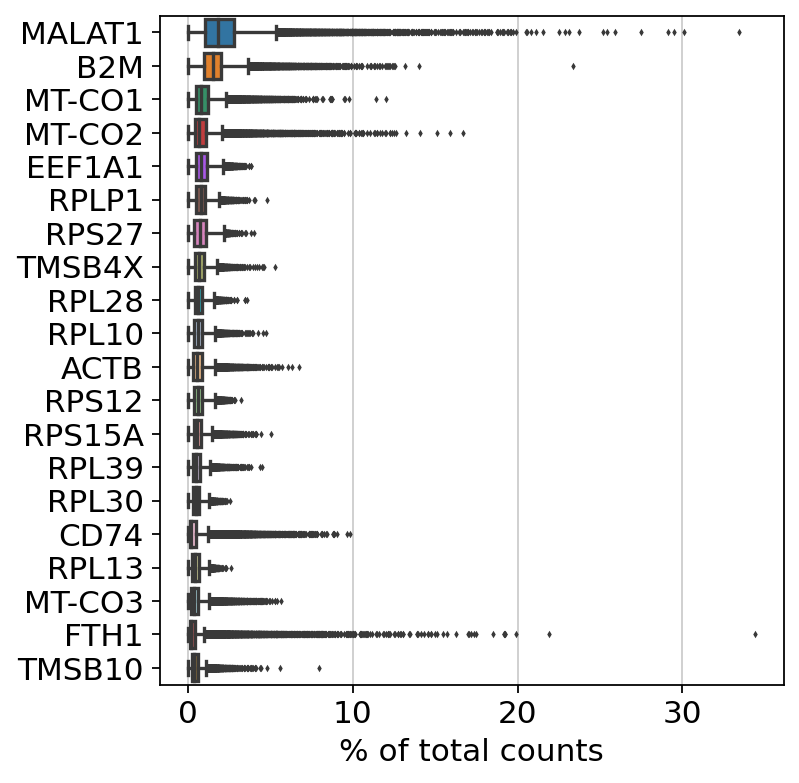

In [36]:
sc.pl.highest_expr_genes(combined, n_top=20)

A few things we can see:
(1) MALAT1 is the highest
(2) a lot of top genes are ribosomal or mitochondrial

As the level of expression of MALAT1 genes are much much higher (which goes up to 34%) than that of the rest genes, we do want to remove them from the dataset to before we encounter technical issues in further steps (due to normalization). We also want to remove mitochondrial genes which only concern dead/dying cells, and MALAT1 and ribosomal genes could create batch effects. There are other ways how these genes can affect downstream analysis results as well. However, before actually removing them, we do a careful check to make sure that these genes don't correpond to a lot of biological significance for samples

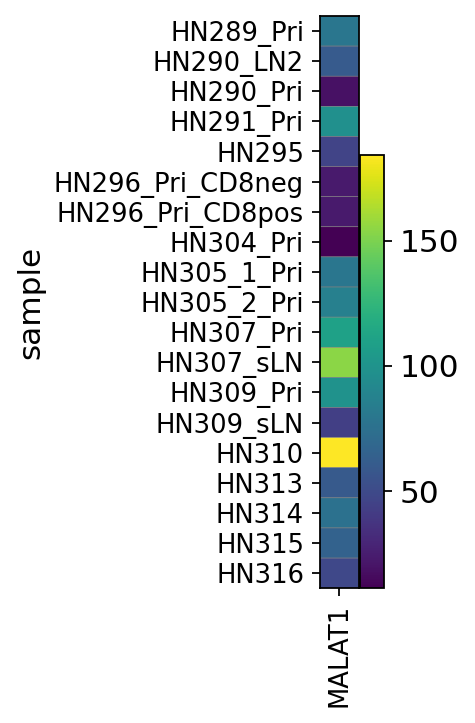

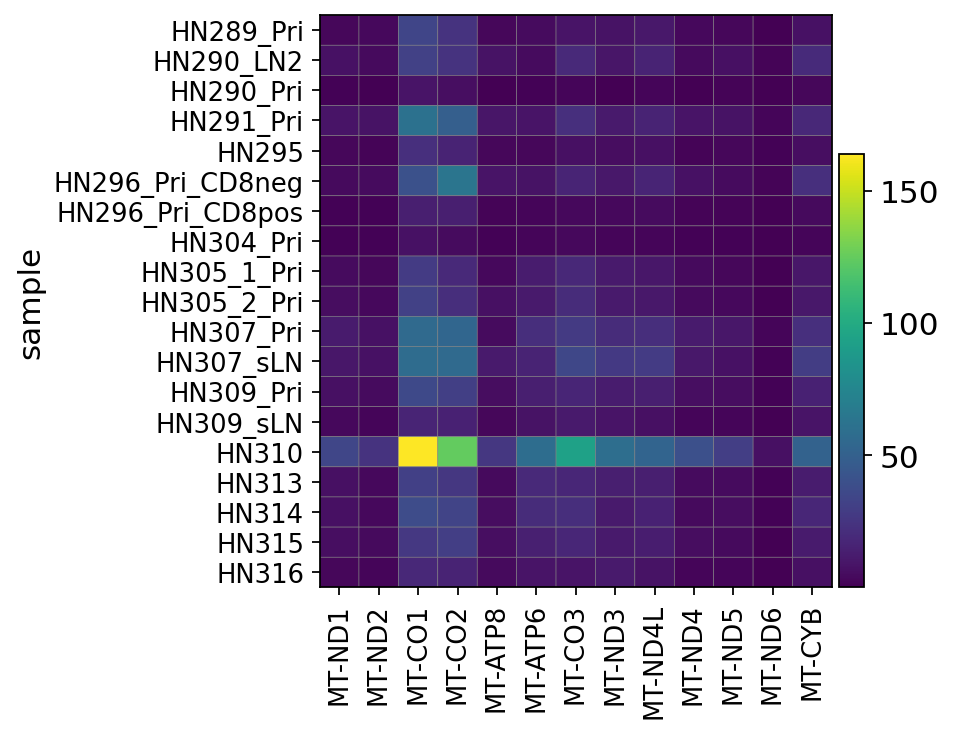

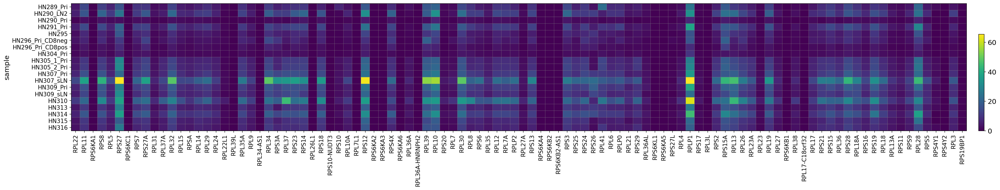

GridSpec(2, 3, height_ratios=[0, 10.5], width_ratios=[32.64, 0, 0.2])

In [37]:
# Look at the distribution of ribosomal genes and mitochondrial genes
 # since some genes have been filtered, we need to reselect mito and ribo from the remaining genes
ribo_genes = combined.var_names.str.startswith(("RPS","RPL"))
mito_genes = combined.var_names.str.startswith('MT-')
malat1 = combined.var_names.str.startswith('MALAT1')

sc.pl.matrixplot(combined, list(combined.var_names[malat1]), groupby='sample')
sc.pl.matrixplot(combined, list(combined.var_names[mito_genes]), groupby='sample')
sc.pl.matrixplot(combined, list(combined.var_names[ribo_genes]), groupby='sample')

#### Based on what we see here, the expression levels of most of these genes in most of the samples are either all high or all low. So we could safely filter them out.

In [38]:
# Filter out MALAT1 and MT- genes which are irrelevant will affect downstream analysis
remove = np.add(ribo_genes,mito_genes)
remove = np.add(remove,malat1)

kept_genes = np.invert(remove)
combined = combined[:,kept_genes]

#### Now look at the number of cells and genes left for each samples and in total

In [39]:
print("After filter, the number of cells in each sample is:")
for sample in dataset_names:
    print("{}: {}".format(sample,str(sum(kept_cell[sample]))))
print("The total number of cells: {}".format(combined.n_obs))

After filter, the number of cells in each sample is:
HN289_Pri: 68
HN290_Pri: 4328
HN295: 5744
HN296_Pri_CD8pos: 3214
HN305_1_Pri: 2011
HN307_Pri: 2072
HN309_Pri: 2000
HN310: 802
HN314: 4655
HN316: 4865
HN290_LN2: 4114
HN291_Pri: 1710
HN296_Pri_CD8neg: 3625
HN304_Pri: 3531
HN305_2_Pri: 1471
HN307_sLN: 3598
HN309_sLN: 4899
HN313: 4953
HN315: 7087
The total number of cells: 64747


normalizing counts per cell
    finished (0:00:00)


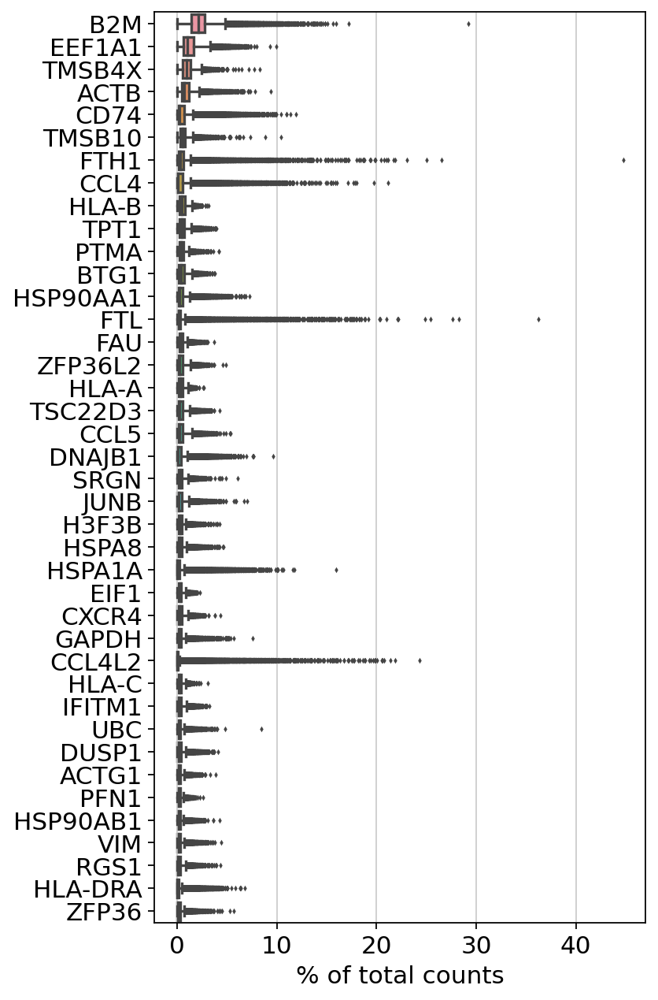

In [40]:
sc.pl.highest_expr_genes(combined, n_top=40)

In [41]:
save_file = '/scratch/qc_filtered_combined_samples.h5ad'
combined.write_h5ad(save_file)